In [1]:
import os, sys
from pathlib import Path
sys.path.append('../src')
sys.path.append('../src/utils/')
from spiking_dataloader import WISDM_spiking_dataloader, WisdmDatasetParser
from inibitory_network.inibitory_network_h1_test import InibitoryLifNet
from lava.proc.io.sink import RingBuffer as SinkRingBuffer
from lava.proc.io.source import RingBuffer as SourceRingBuffer
from lava.proc.monitor.process import Monitor
from output_process import OutputProcess
from lava.proc.monitor.process import Monitor
import matplotlib.pyplot as plt
import numpy as np


In [2]:
dataset = WisdmDatasetParser('../data/data_watch_subset_0_40.npz', norm=None, class_sublset='custom', subset_list=[0, 4, 6, 8, 9, 10, 14])
num_samples = 100 
time_steps = 44
val_idx = 1
val_set = dataset.get_validation_set(subset=num_samples, shuffle=False)
val_set[0].shape

(6,)
(6,)
ytrain shape (55404, 18)
yval shape (18468, 18)
ytest shape (18469, 18)
num classes train dataset: 7 occurrences of each class:[3127 3044 3102 3047 3150 3087 2973]
num classes eval dataset: 7 occurrences of each class:[1035 1048 1122  996 1110 1053 1007]
num classes test dataset: 7 occurrences of each class:[1046 1048 1046 1036 1076 1026  982]


(100, 6, 40)

In [3]:
from lava.proc.lif.process import LIF
from lava.proc.dense.process import Dense
from lava.utils.weightutils import SignMode

path = f"{Path.home()}/snntorch_network/nni_experiments/Inibitory_lif_no_encoder/results/hjulef4s/trials/RHEsE/Trained/network_best.npz"
#path = f"{Path.home()}/snntorch_network/notebook/Trained/network_best.npz"
data = np.load(path,allow_pickle=True)


linear1_w= data['linear1']
leaky1_vth= data['leaky1_vth']
leaky1_betas= 1-data['leaky1_betas'] 
leaky1_betas= leaky1_betas if leaky1_betas >= 0 else np.zeros(leaky1_betas.shape)
print(f"leaky1_betas: {leaky1_betas}")
print(f"leaky1_vth: {leaky1_vth}")
linear2_w = data['linear2']
leaky2_vth= data['recurrent_vth']
leaky2_betas= 1 - data['recurrent_betas']
leaky2_betas= leaky2_betas if  leaky2_betas >= 0 else np.zeros(leaky2_betas.shape)
print(f"leaky2_betas: {leaky2_betas}")
print(f"leaky2_vth: {leaky2_vth}")

recurrent_in_weights = data['input_dense']
recurrent_out_weights = - data['output_dense']
recurrent_vth = data['activation_vth']
recurrent_leaky_betas = 1 - data['activation_betas']
recurrent_leaky_betas= recurrent_leaky_betas if recurrent_leaky_betas >= 0 else np.zeros(recurrent_leaky_betas.shape)
print(f"recurrent_leaky_betas: {recurrent_leaky_betas}")
print(f"recurrent_vth: {recurrent_vth}")

linear3_w = data['linear3']
leaky3_vth= data['leaky2_vth']
leaky3_betas= 1 - data['leaky2_betas']
leaky3_betas= leaky3_betas if leaky3_betas >= 0 else np.zeros(leaky3_betas.shape)
print(f"leaky3_betas: {leaky3_betas}")
print(f"leaky3_vth: {leaky3_vth}")


    

linear1 = Dense(weights=linear1_w, num_message_bits=32, name="linear1")

leaky1 = LIF(shape=(linear1_w.shape[0],),
                    u = np.zeros(linear1_w.shape[0]),
                    v = np.zeros(linear1_w.shape[0]),
                    du = 1.0,
                    dv = leaky1_betas,
                    vth=leaky1_vth,
                    log_config=0,
                    name= "leaky1"
                )
linear1.a_out.connect(leaky1.a_in)
linear2 = Dense(weights=linear2_w, num_message_bits=0, sign_mode=SignMode.MIXED, name="linear2")
linear2.s_in.connect_from(leaky1.s_out)

leaky2 = LIF(shape=(linear2_w.shape[0],),
                    u = np.zeros(linear2_w.shape[0]),
                    v = np.zeros(linear2_w.shape[0]),
                    du = 1.0,
                    dv= leaky2_betas,
                    vth=leaky2_vth,
                    log_config=0,
                    name= "leaky2"
                )
#sum.a_out.connect(leaky2.a_in)
linear2.a_out.connect(leaky2.a_in)
#leaky2.a_in.connect_from(linear2.a_out)

recurrent_in = Dense(weights=recurrent_in_weights, num_message_bits=0, name="recurrent_in")
leaky2.s_out.connect(recurrent_in.s_in)

ahpc = LIF(shape=(recurrent_in_weights.shape[0],),
                    u = np.zeros(recurrent_in_weights.shape[0]),
                    v = np.zeros(recurrent_in_weights.shape[0]),
                    du = 1.0,
                    dv = recurrent_leaky_betas,
                    vth=recurrent_vth,
                    log_config=0,
                    name= "inibitory_leaky"
                )

recurrent_in.a_out.connect(ahpc.a_in)

recurrent_out = Dense(weights=recurrent_out_weights, num_message_bits=0, name="recurrent_out")
recurrent_out.s_in.connect_from(ahpc.s_out)
recurrent_out.a_out.connect(leaky2.a_in)

linear3 = Dense(weights=linear3_w, num_message_bits=0, name="linear3")
linear3.s_in.connect_from(leaky2.s_out)

leaky3 = LIF(shape=(linear3_w.shape[0],),
                    u = np.zeros(linear3_w.shape[0]),
                    v = np.zeros(linear3_w.shape[0]),
                    du = 1.0,
                    dv = leaky3_betas,
                    vth=leaky3_vth,
                    log_config=0,
                    name= "leaky3"
                )
leaky3.a_in.connect_from(linear3.a_out)

leaky1_betas: 0.8172026127576828
leaky1_vth: 1.711238145828247
leaky2_betas: 0.1649174690246582
leaky2_vth: 0.5812320113182068
recurrent_leaky_betas: 0.13742202520370483
recurrent_vth: 1.1815392971038818
leaky3_betas: 0.0
leaky3_vth: 1.5450438261032104


In [4]:
signal_data = np.random.rand(6, time_steps) * 1
input_data = SourceRingBuffer(data = val_set[0][val_idx,:,:])
#input_data = SourceRingBuffer(data = np.ones((6,time_steps))*2)
print(val_set[1][val_idx])

5


In [5]:

from lava.magma.core.run_conditions import RunSteps
from lava.magma.core.run_configs import Loihi1SimCfg, Loihi2SimCfg
from lava.utils.float2fixed import Float2FixedConverter
import numpy as np
#from tqdm import tqdm

converter = Float2FixedConverter()
converter.set_run_cfg(fixed_pt_run_cfg=Loihi1SimCfg(select_tag='fixed_pt'),
                      floating_pt_run_cfg=Loihi1SimCfg(select_tag='floating_pt'))
converter.convert([leaky2, leaky3, ahpc, linear2, recurrent_in, recurrent_out, linear3], num_steps=time_steps)





In [6]:
type(converter.scaled_params[4]['weights'].dtype)


numpy.dtype[int64]

In [7]:
scaled_params_copy = converter.scaled_params.copy()

In [8]:

def update_dict_with_objects(obj_list, dict_to_update):
    for obj in obj_list:
        if obj.id in dict_to_update:
            dict_to_update[obj.name] = dict_to_update.pop(obj.id)

# Example usage
obj_list = [leaky1, leaky2, leaky3, ahpc, linear1, linear2, linear3, recurrent_in, recurrent_out]
update_dict_with_objects(obj_list, scaled_params_copy)
print(scaled_params_copy)

{'leaky2': {'bias_exp': 0, 'bias_mant': 0, 'u': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [9]:
import json
import numpy as np

def serialize_dict(data_dict):
    def convert(obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        if isinstance(obj, np.int64):
            return int(obj)
        raise TypeError(f"Object of type {type(obj)} is not JSON serializable")
    
    return json.dumps(data_dict, default=convert)

def deserialize_dict(json_str):
    def convert(obj):
        if isinstance(obj, list):
            return np.array(obj).astype(np.int64)
        if isinstance(obj, int):
            return np.int64(obj)
        return obj
    
    return json.loads(json_str, object_hook=lambda d: {k: convert(v) for k, v in d.items()})


In [10]:
json_str = serialize_dict(converter.scaled_params)
with open('network_fixed.json', 'w') as json_file:
    json_file.write(json_str)

In [11]:
with open('network_fixed.json', 'r') as json_file:
    loaded_json_str = json_file.read()
loaded_dict = deserialize_dict(loaded_json_str)

In [12]:
print(loaded_dict)

{'3': {'bias_exp': 0, 'bias_mant': 0, 'u': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [7]:
from lava.proc.lif.process import LIF
from lava.proc.dense.process import Dense
from lava.utils.weightutils import SignMode   
from lif_mod import LIFEncoder
from dense_mod import DenseEncoder

linear1 = DenseEncoder(weights=linear1_w, num_message_bits=32, name="linear1")

leaky1 = LIFEncoder(shape=(linear1_w.shape[0],),
                    u = np.zeros(linear1_w.shape[0]),
                    v = np.zeros(linear1_w.shape[0]),
                    du = 1.0,
                    dv = leaky1_betas,
                    vth=leaky1_vth,
                    log_config=0,
                    name= "leaky1"
                )

linear1.a_out.connect(leaky1.a_in)
linear2 = Dense(**converter.scaled_params[linear2.id],
                sign_mode=SignMode.MIXED, name="linear2")

linear2.s_in.connect_from(leaky1.s_out)

leaky2 = LIF(shape=(linear2_w.shape[0],),
                    **converter.scaled_params[leaky2.id],
                    name= "leaky2"
                )
#sum.a_out.connect(leaky2.a_in)
linear2.a_out.connect(leaky2.a_in)
#leaky2.a_in.connect_from(linear2.a_out)

recurrent_in = Dense(**converter.scaled_params[recurrent_in.id],
                     name="recurrent_in")

leaky2.s_out.connect(recurrent_in.s_in)

ahpc = LIF(shape=(recurrent_in_weights.shape[0],),
                    **converter.scaled_params[ahpc.id],
                    log_config=0,
                    name= "inibitory_leaky"
                )

recurrent_in.a_out.connect(ahpc.a_in)

recurrent_out = Dense(**converter.scaled_params[recurrent_out.id],
                       name="recurrent_out")
recurrent_out.s_in.connect_from(ahpc.s_out)
recurrent_out.a_out.connect(leaky2.a_in)

linear3 = Dense(**converter.scaled_params[linear3.id],
                name="linear3")

linear3.s_in.connect_from(leaky2.s_out)

leaky3 = LIF(shape=(linear3_w.shape[0],),
                    **converter.scaled_params[leaky3.id],
                    log_config=0,
                    name= "leaky3"
                )
leaky3.a_in.connect_from(linear3.a_out)

monitor_leaky1_u = Monitor()
monitor_leaky1_u.probe(target=leaky1.v, num_steps=time_steps)

monitor_leaky2_u = Monitor()
monitor_leaky2_u.probe(target=leaky2.v, num_steps=time_steps)

monitor_leaky3_u = Monitor()
monitor_leaky3_u.probe(target=leaky3.v, num_steps=time_steps)

monitor_recurrent_u = Monitor()
monitor_recurrent_u.probe(target=ahpc.v, num_steps=time_steps)

in_sink = SinkRingBuffer(shape=(120,), buffer=time_steps)
b_sink = SinkRingBuffer(shape=(400,), buffer=time_steps)
f_sink = SinkRingBuffer(shape=(400,),buffer=time_steps)
out_sink = SinkRingBuffer(shape=(7,),buffer=time_steps)

input_data.s_out.connect(linear1.s_in)
leaky1.s_out.connect(in_sink.a_in)
leaky3.s_out.connect(out_sink.a_in)
ahpc.s_out.connect(b_sink.a_in)
leaky2.s_out.connect(f_sink.a_in)



In [8]:
from lava.magma.core.run_conditions import RunSteps
from lava.magma.core.run_configs import Loihi1SimCfg, Loihi2SimCfg

leaky1.run(condition=RunSteps(num_steps=time_steps),
                run_cfg=Loihi1SimCfg(select_tag='fixed_pt'))

leaky1_u = monitor_leaky1_u.get_data()
_ , leaky1_u = next(iter(leaky1_u.items()))
_ , leaky1_u_fixed = next(iter(leaky1_u.items()))
leaky2_u = monitor_leaky2_u.get_data()
_ , leaky2_u = next(iter(leaky2_u.items()))
_ , leaky2_u_fixed = next(iter(leaky2_u.items()))
leaky3_u = monitor_leaky3_u.get_data()
_ , leaky3_u = next(iter(leaky3_u.items()))
_ , leaky3_u_fixed = next(iter(leaky3_u.items()))
recurrent_u = monitor_recurrent_u.get_data()
_ , recurrent_u = next(iter(recurrent_u.items()))
_ , recurrent_u_fixed = next(iter(recurrent_u.items()))

out_data_fixed = np.array(out_sink.data.get())
in_data_fixed= np.array(in_sink.data.get())
b_data_fixed = np.array(b_sink.data.get())
f_data_fixed = np.array(f_sink.data.get())

print(leaky1_u_fixed.shape)
print(leaky2_u_fixed.shape)

leaky1.stop()

(44, 120)
(44, 400)


In [9]:
del leaky1
del leaky2
del leaky3
del ahpc
del linear1
del linear2
del linear3
del recurrent_in
del recurrent_out
del monitor_leaky1_u
del monitor_leaky2_u
del monitor_leaky3_u
del monitor_recurrent_u
del in_sink
del b_sink
del f_sink
del out_sink
del input_data



In [10]:
signal_data = np.random.rand(6, time_steps) * 1
input_data = SourceRingBuffer(data = val_set[0][val_idx,:,:])
#input_data = SourceRingBuffer(data = np.ones((6,time_steps))*2)
print(val_set[1][val_idx])

5


In [11]:
from lava.proc.lif.process import LIF
from lava.proc.dense.process import Dense
from lava.utils.weightutils import SignMode


linear1 = DenseEncoder(weights=linear1_w, num_message_bits=32, name="linear1")

leaky1 = LIFEncoder(shape=(linear1_w.shape[0],),
                    u = np.zeros(linear1_w.shape[0]),
                    v = np.zeros(linear1_w.shape[0]),
                    du = 1.0,
                    dv = leaky1_betas,
                    vth=leaky1_vth,
                    log_config=0,
                    name= "leaky1"
                )
linear1.a_out.connect(leaky1.a_in)
linear2 = Dense(weights=linear2_w, num_message_bits=0, sign_mode=SignMode.MIXED, name="linear2")
linear2.s_in.connect_from(leaky1.s_out)

leaky2 = LIF(shape=(linear2_w.shape[0],),
                    u = np.zeros(linear2_w.shape[0]),
                    v = np.zeros(linear2_w.shape[0]),
                    du = 1.0,
                    dv= leaky2_betas,
                    vth=leaky2_vth,
                    log_config=0,
                    name= "leaky2"
                )
#sum.a_out.connect(leaky2.a_in)
linear2.a_out.connect(leaky2.a_in)
#leaky2.a_in.connect_from(linear2.a_out)

recurrent_in = Dense(weights=recurrent_in_weights, num_message_bits=0, name="recurrent_in")
leaky2.s_out.connect(recurrent_in.s_in)

ahpc = LIF(shape=(recurrent_in_weights.shape[0],),
                    u = np.zeros(recurrent_in_weights.shape[0]),
                    v = np.zeros(recurrent_in_weights.shape[0]),
                    du = 1.0,
                    dv = recurrent_leaky_betas,
                    vth=recurrent_vth,
                    log_config=0,
                    name= "inibitory_leaky"
                )

recurrent_in.a_out.connect(ahpc.a_in)

recurrent_out = Dense(weights=recurrent_out_weights, num_message_bits=0, name="recurrent_out")
recurrent_out.s_in.connect_from(ahpc.s_out)
recurrent_out.a_out.connect(leaky2.a_in)

linear3 = Dense(weights=linear3_w, num_message_bits=0, name="linear3")
linear3.s_in.connect_from(leaky2.s_out)

leaky3 = LIF(shape=(linear3_w.shape[0],),
                    u = np.zeros(linear3_w.shape[0]),
                    v = np.zeros(linear3_w.shape[0]),
                    du = 1.0,
                    dv = leaky3_betas,
                    vth=leaky3_vth,
                    log_config=0,
                    name= "leaky3"
                )
leaky3.a_in.connect_from(linear3.a_out)

# monitor_ring = Monitor()
# monitor_ring.probe(target=SourceRingBuffer.
monitor_leaky1_u = Monitor()
monitor_leaky1_u.probe(target=leaky1.v, num_steps=time_steps)

monitor_leaky2_u = Monitor()
monitor_leaky2_u.probe(target=leaky2.v, num_steps=time_steps)

monitor_leaky3_u = Monitor()
monitor_leaky3_u.probe(target=leaky3.v, num_steps=time_steps)

monitor_recurrent_u = Monitor()
monitor_recurrent_u.probe(target=ahpc.v, num_steps=time_steps)

in_sink = SinkRingBuffer(shape=(120,), buffer=time_steps)
b_sink = SinkRingBuffer(shape=(400,), buffer=time_steps)
f_sink = SinkRingBuffer(shape=(400,),buffer=time_steps)
out_sink = SinkRingBuffer(shape=(7,),buffer=time_steps)

input_data.s_out.connect(linear1.s_in)
leaky1.s_out.connect(in_sink.a_in)
leaky3.s_out.connect(out_sink.a_in)
ahpc.s_out.connect(b_sink.a_in)
leaky2.s_out.connect(f_sink.a_in)

In [12]:

from lava.magma.core.run_conditions import RunSteps
from lava.magma.core.run_configs import Loihi1SimCfg, Loihi2SimCfg

leaky1.run(condition=RunSteps(num_steps=time_steps),
                run_cfg=Loihi1SimCfg(select_sub_proc_model=True,
                select_tag='floating_pt'))

leaky1_u = monitor_leaky1_u.get_data()
_ , leaky1_u = next(iter(leaky1_u.items()))
_ , leaky1_u_float = next(iter(leaky1_u.items()))
leaky2_u = monitor_leaky2_u.get_data()
_ , leaky2_u = next(iter(leaky2_u.items()))
_ , leaky2_u_float = next(iter(leaky2_u.items()))
leaky3_u = monitor_leaky3_u.get_data()
_ , leaky3_u = next(iter(leaky3_u.items()))
_ , leaky3_u_float = next(iter(leaky3_u.items()))
recurrent_u = monitor_recurrent_u.get_data()
_ , recurrent_u = next(iter(recurrent_u.items()))
_ , recurrent_u_float = next(iter(recurrent_u.items()))

out_data_float = np.array(out_sink.data.get())
in_data_float= np.array(in_sink.data.get())
b_data_float = np.array(b_sink.data.get())
f_data_float = np.array(f_sink.data.get())

print(leaky1_u_float.shape)
print(leaky2_u_float.shape)

leaky1.stop()

(44, 120)
(44, 400)


In [13]:

def create_raster_plot(data, name=None, figsize=None):
    plt.clf()
    if figsize is None:
        channels, timesteps = data.shape
        x_size = timesteps / 2
        y_size = channels / 10 if channels > 100 else channels 
        figsize = (x_size, y_size)
    else:
        figsize = figsize

    plt.figure(figsize=figsize)
    print(data.shape)
    for channel in range(data.shape[0]):
        spike_times = np.where(data[channel])[0]
        plt.vlines(spike_times, channel + 0.5, channel + 1.5)

    if name:
        plt.title(f"{name} Raster Plot")
    else:
        plt.title('Raster Plot')

    plt.yticks(np.arange(0, data.shape[0] + 1), [f'N {i}' for i in range(0, data.shape[0]+1)])
    plt.xlabel('Time (ms)')
    plt.ylabel('Channels')
    plt.ylim(0, data.shape[0])
    plt.xlim(0, data.shape[1])
    plt.xticks(ticks=np.arange(data.shape[1]), labels=np.arange(data.shape[1]))
    plt.grid(axis='x', color='black', linestyle='--', linewidth=0.2)
    plt.show()


# Generate the raster plot

def plot_signals(matrix, name=None, figsize=None):
    """
    Plots the signal for each channel in the provided matrix.
    
    Parameters:
    matrix (np.ndarray): A 2D array where the first dimension represents channels
                         and the second dimension represents timesteps.
    """
    channels, timesteps = matrix.shape

    if figsize is None:
        x_size = timesteps / 2
        y_size = int(channels / 10) if channels > 100 else channels 
        figsize = (x_size, y_size)
    else:
        figsize = figsize

    plt.figure(figsize=figsize)
    for i in range(channels):
        plt.plot(matrix[i], label=f'Channel {i+1}')
    
    if name:
        plt.title(f"{name} Signal Plot")
    else:
        plt.title('Signal Plot')

    plt.xlabel('Timestep')
    plt.ylabel('Signal Value')
    plt.xlim(0, matrix.shape[1])
    plt.xticks(ticks=np.arange(matrix.shape[1]), labels=np.arange(matrix.shape[1]))
    plt.grid(axis='x', color='black', linestyle='--', linewidth=0.2)
    plt.legend(ncol=12, loc='upper center', bbox_to_anchor=(0.5, -0.05), facecolor='white', framealpha=1)
    plt.show()

def plot_signals_subplot(matrix1, matrix2, name1=None, name2=None, figsize=None):
    """
    Plots the signal for each channel in the provided matrices side by side.
    
    Parameters:
    matrix1 (np.ndarray): A 2D array where the first dimension represents channels
                        and the second dimension represents timesteps.
    matrix2 (np.ndarray): A 2D array where the first dimension represents channels
                        and the second dimension represents timesteps.
    """
    channels1, timesteps1 = matrix1.shape
    channels2, timesteps2 = matrix2.shape

    if figsize is None:
        x_size = max(timesteps1, timesteps2) 
        y_size = max(channels1, channels2) / 20 if max(channels1, channels2) > 100 else max(channels1, channels2)
        figsize = (x_size, y_size)
    else:
        figsize = figsize

    fig, axs = plt.subplots(1, 2, figsize=figsize)
    
    for i in range(channels1):
        axs[0].plot(matrix1[i], label=f'Channel {i+1}')
    for i in range(channels2):
        axs[1].plot(matrix2[i], label=f'Channel {i+1}')
    
    if name1:
        axs[0].set_title(f"{name1} Signal Plot")
    else:
        axs[0].set_title('Signal Plot 1')
    
    if name2:
        axs[1].set_title(f"{name2} Signal Plot")
    else:
        axs[1].set_title('Signal Plot 2')

    for ax in axs:
        ax.set_xlabel('Timestep')
        ax.set_ylabel('Signal Value')
        ax.set_xlim(0, max(timesteps1, timesteps2))
        ax.set_xticks(ticks=np.arange(max(timesteps1, timesteps2)), labels=np.arange(max(timesteps1, timesteps2)))
        ax.grid(axis='x', color='black', linestyle='--', linewidth=0.2)
        # ax.legend(ncol=12, loc='upper center', bbox_to_anchor=(0.5, -0.05), facecolor='white', framealpha=1)
    
    plt.show()

def create_raster_plot_subplot(data1, data2, name1=None, name2=None, figsize=None):
    """
    Creates raster plots for the provided data side by side.
    
    Parameters:
    data1 (np.ndarray): A 2D array where the first dimension represents channels
                        and the second dimension represents timesteps.
    data2 (np.ndarray): A 2D array where the first dimension represents channels
                        and the second dimension represents timesteps.
    """
    if figsize is None:
        channels1, timesteps1 = data1.shape
        channels2, timesteps2 = data2.shape
        x_size = int(max(timesteps1, timesteps2) / 1.5  )
        y_size = max(channels1, channels2) / 20 if max(channels1, channels2) > 100 else max(channels1, channels2) / 2
        figsize = (x_size, y_size)
    else:
        figsize = figsize
# Assuming obj is leaky2
obj = leaky2

# Search and replace key in the dictionary
if obj.id in scaled_params_copy:
    scaled_params_copy[obj.name] = scaled_params_copy.pop(obj.id)

print(scaled_params_copy)
    fig, axs = plt.subplots(1, 2, figsize=figsize)
    
    for channel in range(data1.shape[0]):
        spike_times = np.where(data1[channel])[0]
        axs[0].vlines(spike_times, channel + 0.5, channel + 1.5)
    
    for channel in range(data2.shape[0]):
        spike_times = np.where(data2[channel])[0]
        axs[1].vlines(spike_times, channel + 0.5, channel + 1.5)

    if name1:
        axs[0].set_title(f"{name1} Raster Plot")
    else:
        axs[0].set_title('Raster Plot 1')
    
    if name2:
        axs[1].set_title(f"{name2} Raster Plot")
    else:
        axs[1].set_title('Raster Plot 2')

    for ax in axs:
        ax.set_yticks(np.arange(0, max(data1.shape[0], data2.shape[0]) + 1), [f'N {i}' for i in range(0, max(data1.shape[0], data2.shape[0]) + 1)])
        ax.set_xlabel('Time (ms)')
        ax.set_ylabel('Channels')
        ax.set_ylim(0, max(data1.shape[0], data2.shape[0]))
        ax.set_xlim(0, max(data1.shape[1], data2.shape[1]))
        ax.set_xticks(ticks=np.arange(max(data1.shape[1], data2.shape[1])), labels=np.arange(max(data1.shape[1], data2.shape[1])))
        ax.grid(axis='x', color='black', linestyle='--', linewidth=0.3)
    
    plt.show()



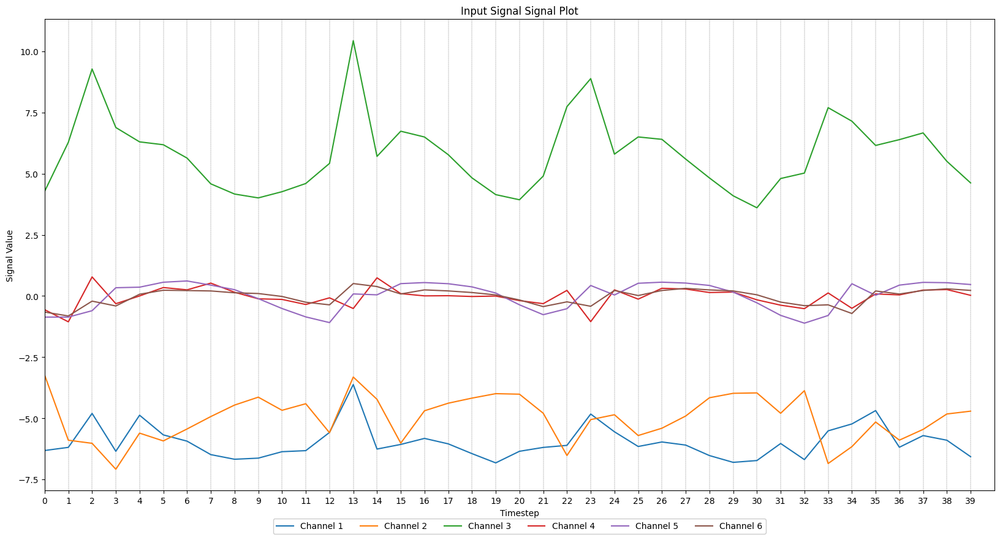

In [14]:
plot_signals(val_set[0][val_idx,:,:], figsize=(20,10), name='Input Signal')

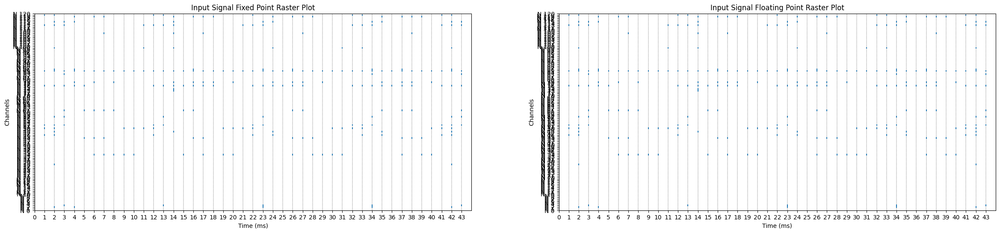

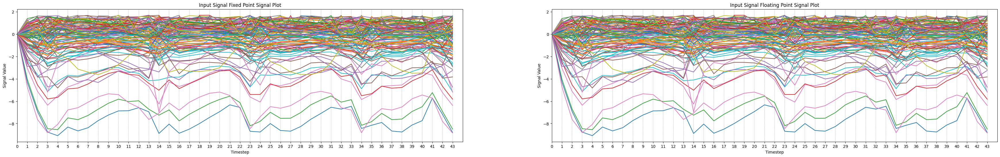

In [15]:
create_raster_plot_subplot(in_data_fixed, in_data_float, name1='Input Signal Fixed Point', name2='Input Signal Floating Point')
plot_signals_subplot(leaky1_u_fixed.T, leaky1_u_float.T, name1='Input Signal Fixed Point', name2='Input Signal Floating Point')

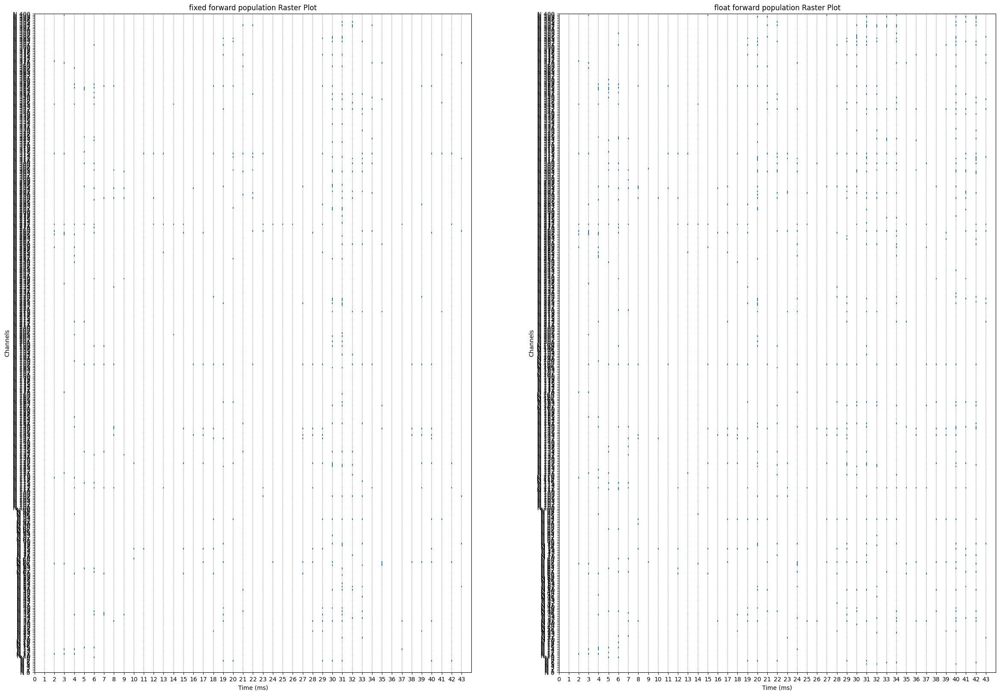

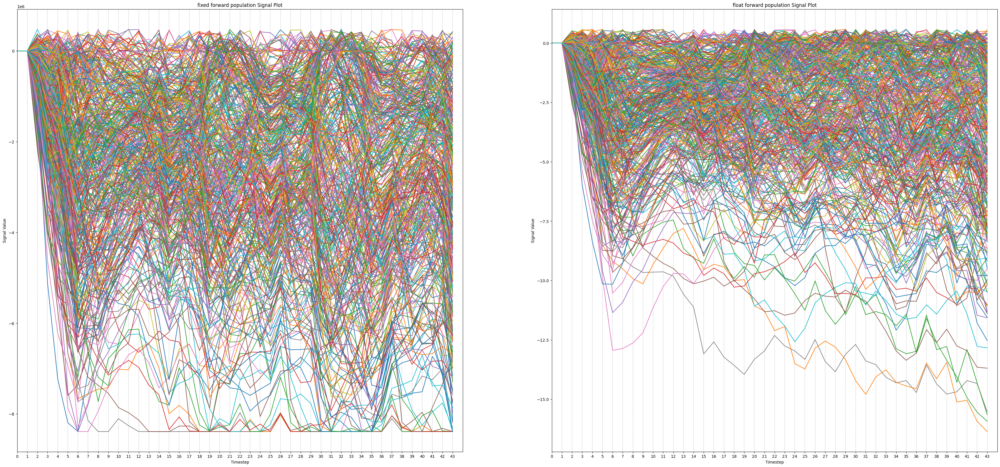

In [16]:
create_raster_plot_subplot(f_data_fixed, f_data_float, name1='fixed forward population', name2='float forward population') 
plot_signals_subplot(leaky2_u_fixed.T, leaky2_u_float.T, name1='fixed forward population', name2='float forward population')


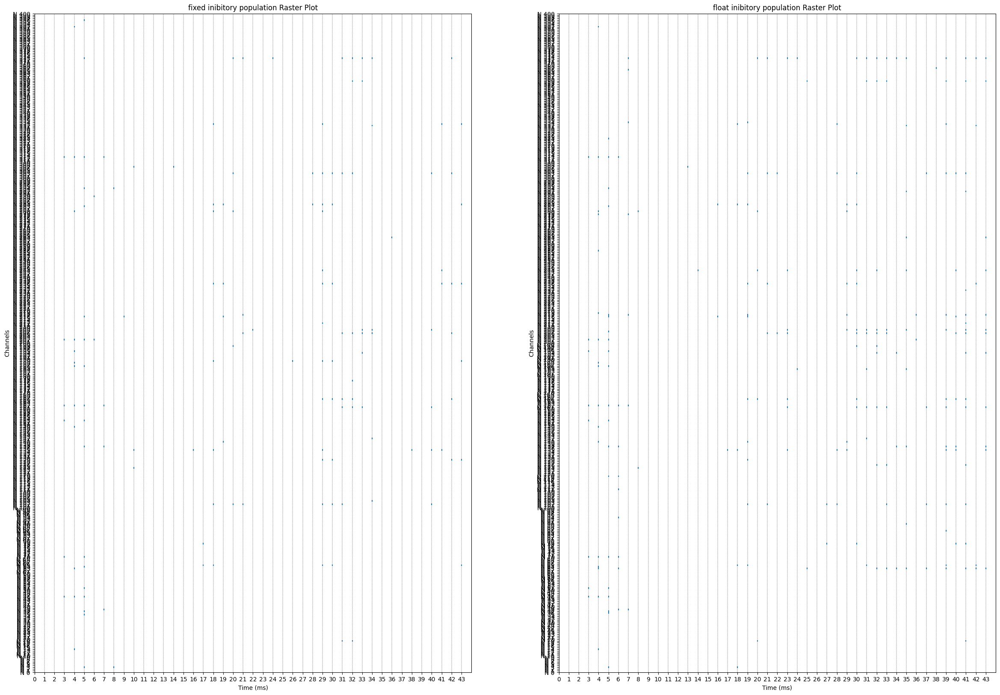

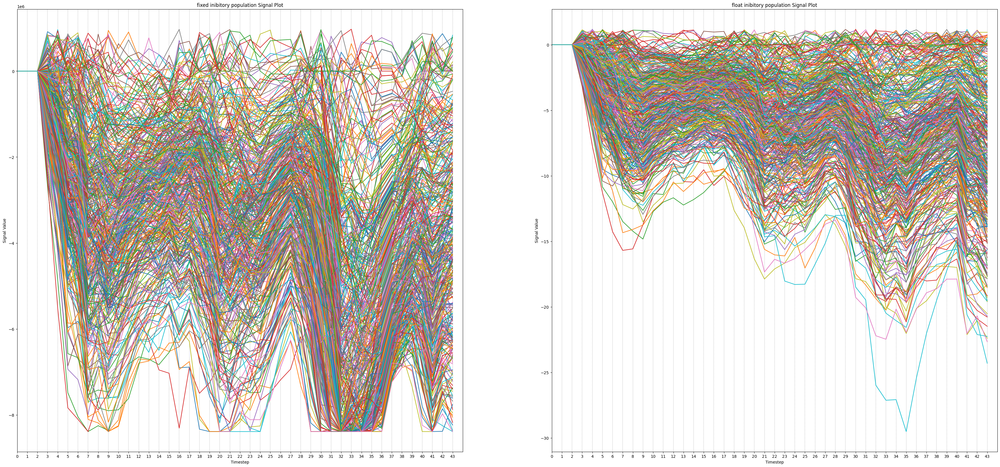

In [17]:
create_raster_plot_subplot(b_data_fixed, b_data_float, name1='fixed inibitory population', name2='float inibitory population')
plot_signals_subplot(recurrent_u_fixed.T, recurrent_u_float.T, name1='fixed inibitory population', name2='float inibitory population')


correct label: 5
predicted label fixed: 5
predicted label float: 5


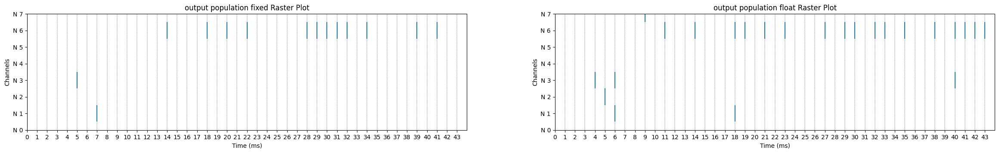

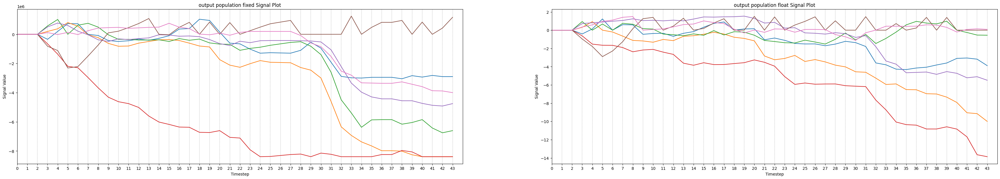

In [18]:
print(f"correct label: {val_set[1][val_idx]}")
print(f"predicted label fixed: {np.argmax(np.sum(out_data_fixed, axis=-1))}")
print(f"predicted label float: {np.argmax(np.sum(out_data_float, axis=-1))}")
create_raster_plot_subplot(out_data_fixed, out_data_float, name1='output population fixed', name2='output population float')
plot_signals_subplot(leaky3_u_fixed.T, leaky3_u_float.T, name1='output population fixed', name2='output population float')


In [19]:
float_v = np.array([0.8]).astype(np.float32)
print(float_v)
int_v = float_v.astype(np.int32)
print(int_v)

[0.8]
[0]


In [20]:
float_v = np.array([1.8]).astype(np.float32)
print(float_v)
int_v = float_v.astype(np.int32)
print(int_v)

[1.8]
[1]
